In [1]:
# imports
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# pandas display options
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

random_state = 42
np.random.seed(random_state)

base_path = 'xai'
os.makedirs(base_path, exist_ok=True)
figures_path = os.path.join(base_path, 'figures')
os.makedirs(figures_path, exist_ok=True)
data_path = 'data'
file_name = 'season.csv'
years = range(2019, 2023)

In [2]:
from f1pitpred.loading import load_from_csv
data = load_from_csv(years, data_path, file_name)

# Preprocessing

In [3]:
from f1pitpred.preprocessing import get_preprocessed_train_test_split
df = data.copy()
train, test, train_groups, test_groups = get_preprocessed_train_test_split(
    df, 
    0.2, 
    return_groups=True, 
    random_state=random_state
)

from f1pitpred.preprocessing import get_x_y
X_train, y_train = get_x_y(train)
X_test, y_test = get_x_y(test)

# Modelisation

In [4]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix
def specificity(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    tn, fp, fn, tp = cm.ravel()
    return tn / (tn + fp)

def balanced_accuracy(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    tn, fp, fn, tp = cm.ravel()
    specificity = tn / (tn + fp)
    sensitivity = tp / (tp + fn)
    return (specificity + sensitivity) / 2

In [5]:
model = RandomForestClassifier(
    n_estimators=2000,
    max_depth=5, 
    max_features='sqrt',
    criterion='entropy',
    class_weight='balanced_subsample',
    random_state=random_state,
    n_jobs=-1
)

model.fit(X_train, y_train)

RandomForestClassifier(class_weight='balanced_subsample', criterion='entropy',
                       max_depth=5, n_estimators=2000, n_jobs=-1,
                       random_state=42)

In [6]:
y_pred = model.predict(X_test)

print("Balanced accuracy : ", balanced_accuracy(y_test, y_pred))
print("Specificity : ", specificity(y_test, y_pred))

Balanced accuracy :  0.7172119125477225
Specificity :  0.7417286109896517


In [16]:
from sklearn.metrics import classification_report
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[10178  3544]
 [  122   275]]
              precision    recall  f1-score   support

       False       0.99      0.74      0.85     13722
        True       0.07      0.69      0.13       397

    accuracy                           0.74     14119
   macro avg       0.53      0.72      0.49     14119
weighted avg       0.96      0.74      0.83     14119



In [8]:
from lime import lime_tabular

explainer = lime_tabular.LimeTabularExplainer(
    X_train.values,
    feature_names=X_train.columns,
    class_names=['No Pit', 'Pit'],
    mode='classification',
    discretize_continuous=True,
    random_state=random_state
)

In [19]:
import pickle
encoder_path = os.path.join("models", "f1_score", "encoder.pkl")
encoder = pickle.load(open(encoder_path, 'rb'))

validation_races = load_from_csv([2023], data_path, file_name)

In [27]:
from f1pitpred.preprocessing import preprocess_new_data
race = validation_races.query('DriverNumber == "1" and Track == "Barcelona"').reset_index(drop=True)
race_preprocessed = preprocess_new_data(race, encoder)

In [54]:
x_13 = race_preprocessed.query('LapNumber == 13').drop(['is_pitting'], axis=1).iloc[0]
x_27 = race_preprocessed.query('LapNumber == 27').drop(['is_pitting'], axis=1).iloc[0]

In [59]:
exp = explainer.explain_instance(
        x_13,
        model.predict_proba,
        num_features=10,
    )

exp.show_in_notebook(show_table=True)
exp.save_to_file(f'explanation_barcelona_verstappen_13.html')

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


In [61]:
exp = explainer.explain_instance(
        x_27.drop(columns=['is_pitting']),
        model.predict_proba,
        num_features=10,
    )

exp.show_in_notebook(show_table=True)
exp.save_to_file(f'explanation_barcelona_verstappen_27.html')

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


In [46]:
from f1pitpred.plotting import plot_race_predictions, plot_stoppages, plot_tyres
def explain_race(race_id):
    race = list(test_groups.keys())[race_id]

    driver_number = race[2]
    track = race[1]
    year = race[0]

    test_race_x = X_test.iloc[test_groups.get(race)].reset_index(drop=True)
    test_race_x['index'] = test_race_x['LapNumber']
    test_race_x.set_index('index', inplace=True)
    test_race_y = y_test.iloc[test_groups.get(race)].reset_index(drop=True)
    test_race_y.index = test_race_x.index
    probabilities = model.predict_proba(test_race_x)[::,1]

    _, ax = plt.subplots(figsize=(15, 5))
    ax.grid(True)
    plot_race_predictions(test_race_x, test_race_y, probabilities, ax, title=f'Race {track} {year} of driver {driver_number}')
    plot_stoppages(test_race_x, ax)
    plot_tyres(test_race_x, ax)

    #plt.savefig(f'{figures_path}/preds_{race_id}.png', bbox_inches='tight')
    plt.show()

    pit_id = np.where(test_race_y == 1)[0][0]
    print(type(test_race_x.iloc[pit_id]))
    exp = explainer.explain_instance(
        test_race_x.iloc[pit_id],
        model.predict_proba,
        num_features=10,
        top_labels=1
    )

    exp.show_in_notebook(show_table=True)
    #exp.save_to_file(f'{figures_path}/explanation_{race_id}.html')

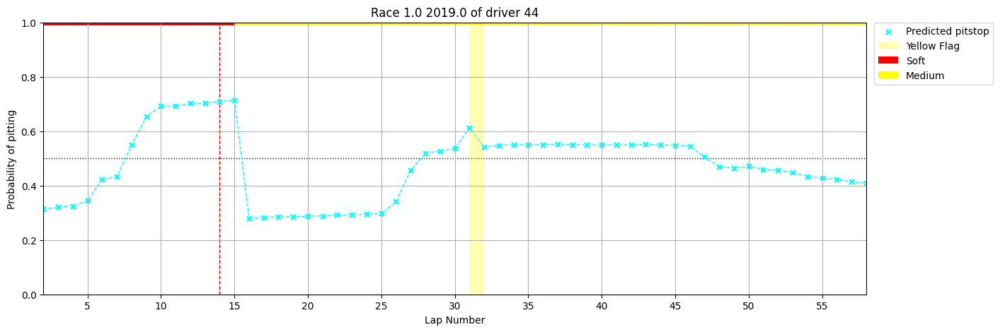

<class 'pandas.core.series.Series'>


c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


In [47]:
explain_race(0)

       LapNumber     LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                 

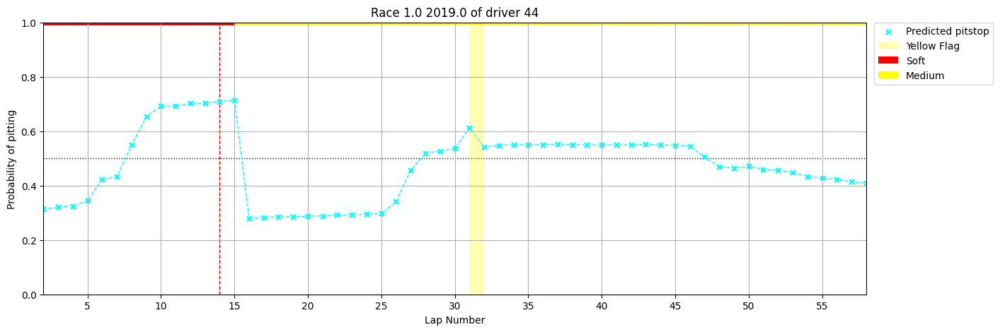

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber     LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                 

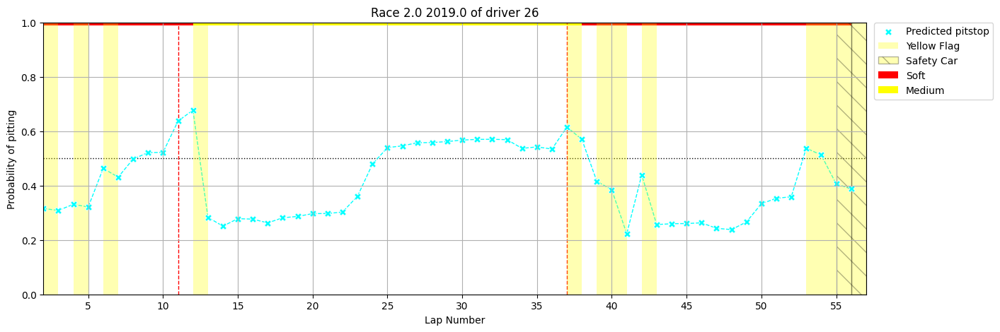

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber     LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                 

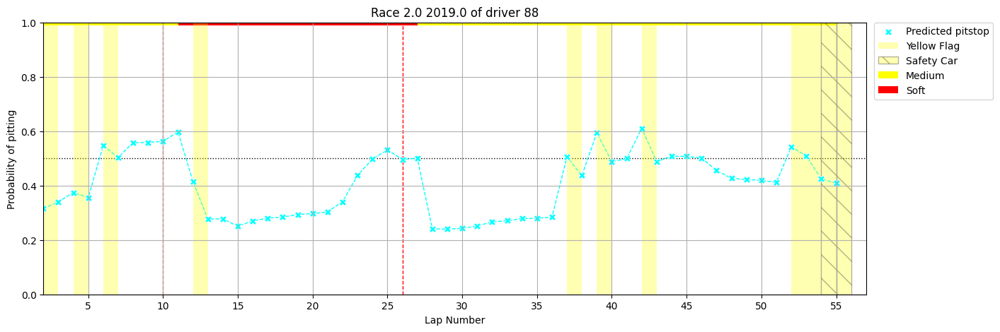

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber     LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                 

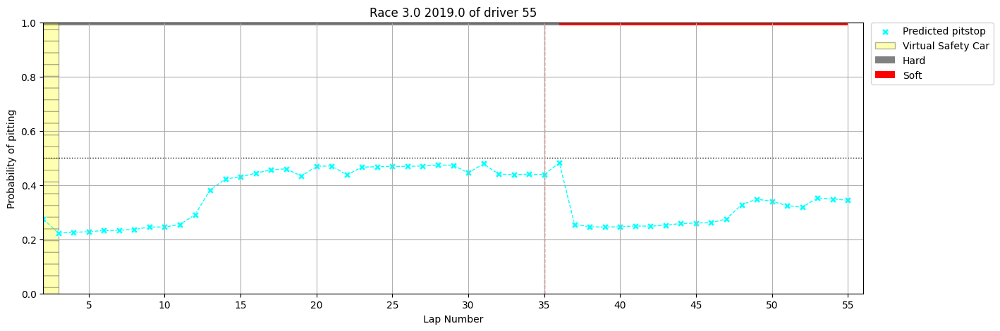

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber     LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                 

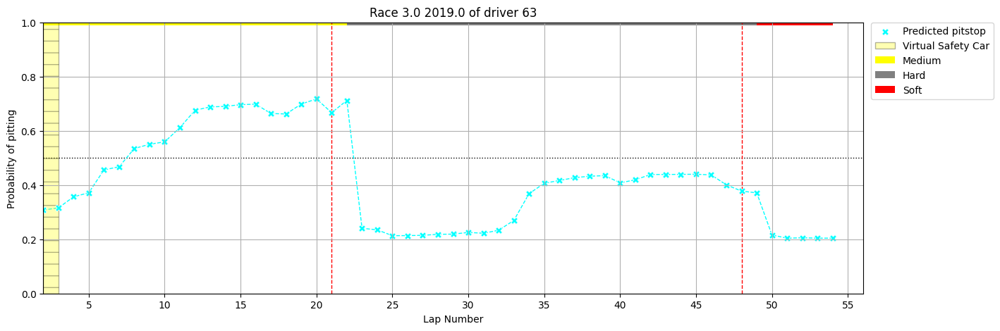

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber     LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                 

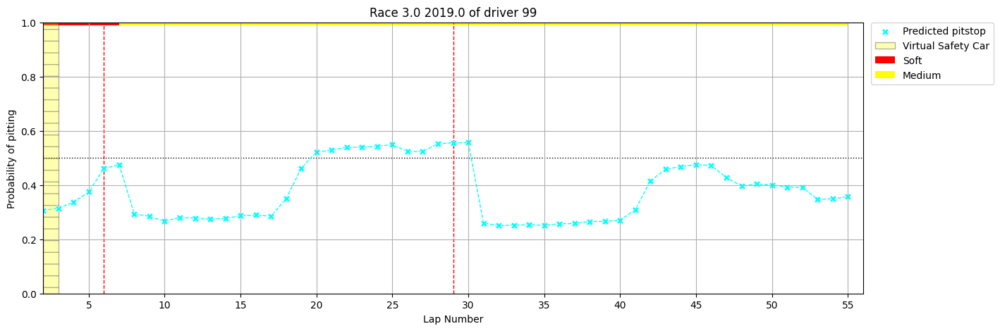

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber     LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                 

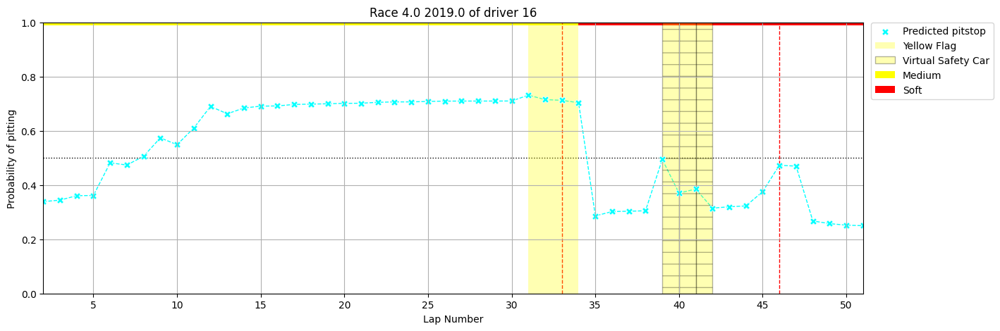

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber     LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                 

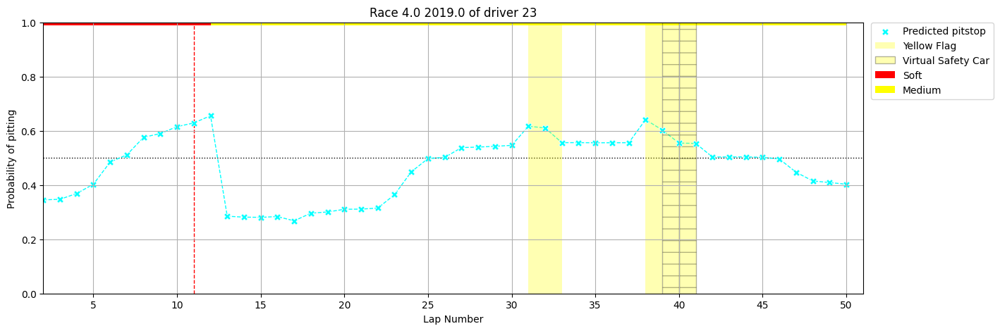

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber     LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                 

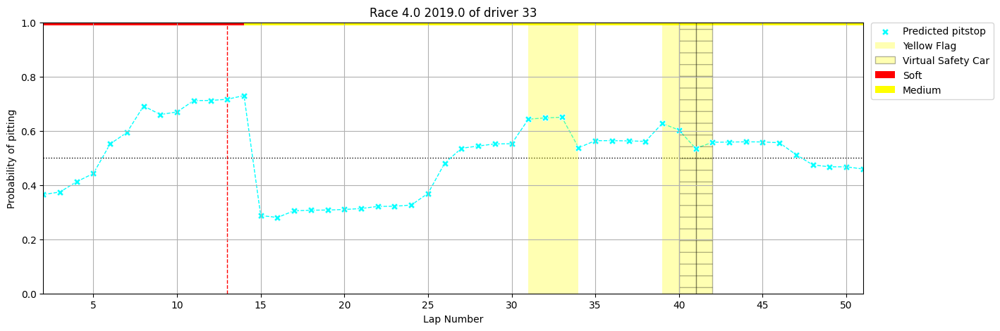

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber     LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                 

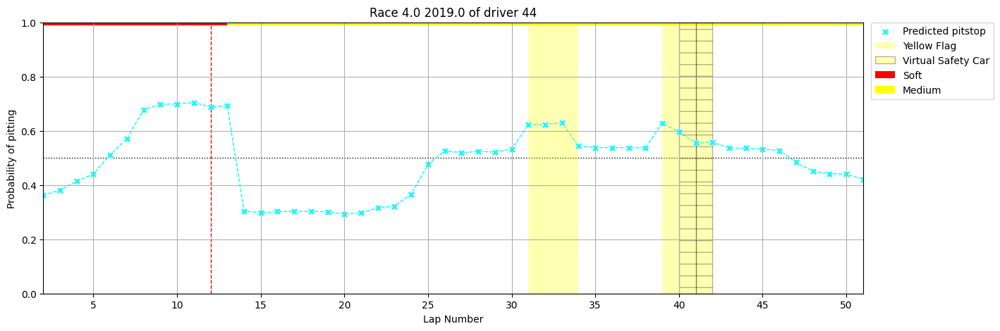

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber     LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                 

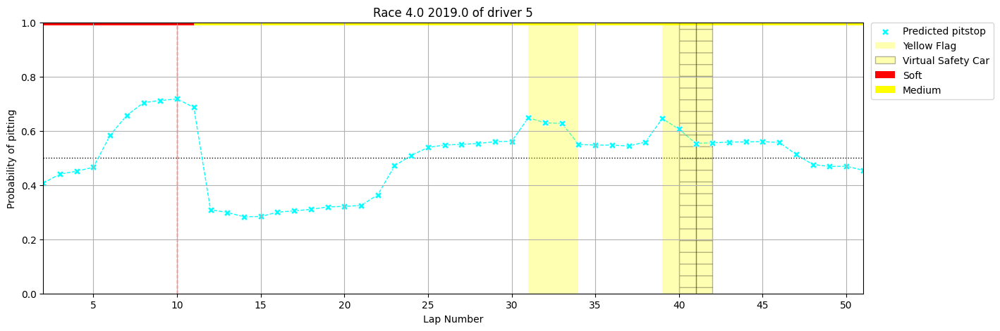

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber     LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                 

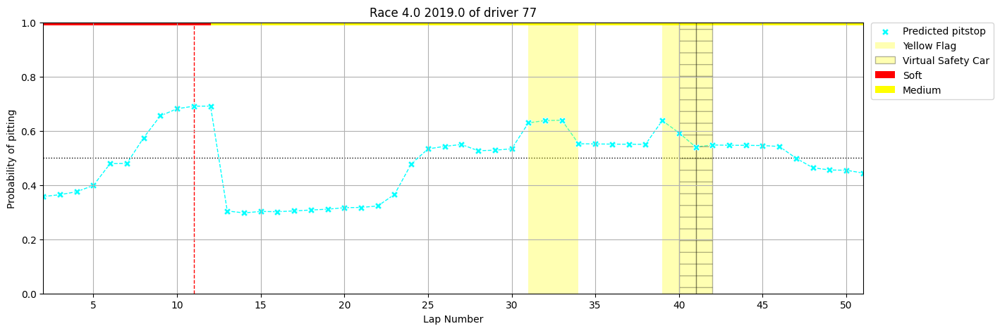

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber    LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                  

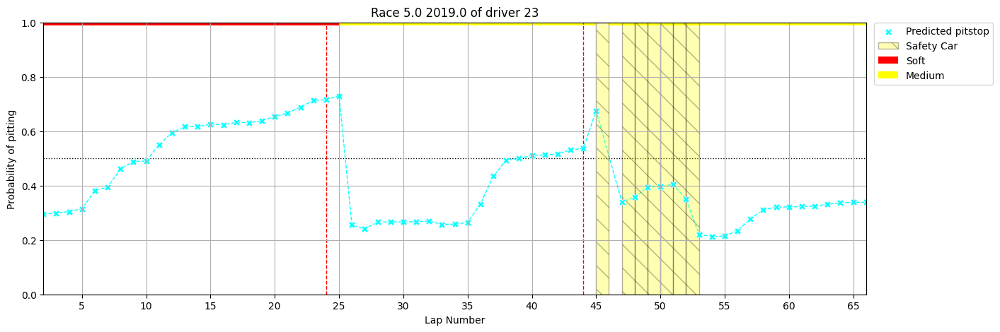

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber    LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                  

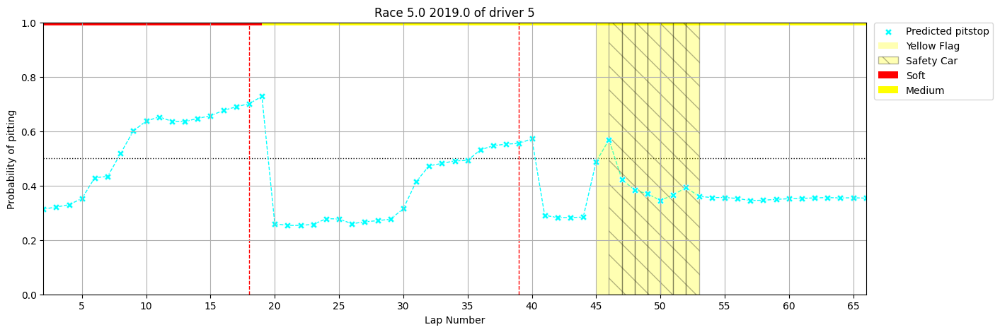

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber    LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                  

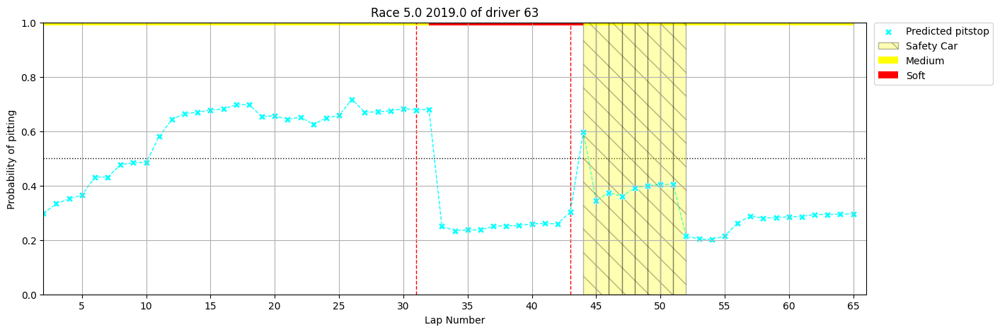

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber    LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                  

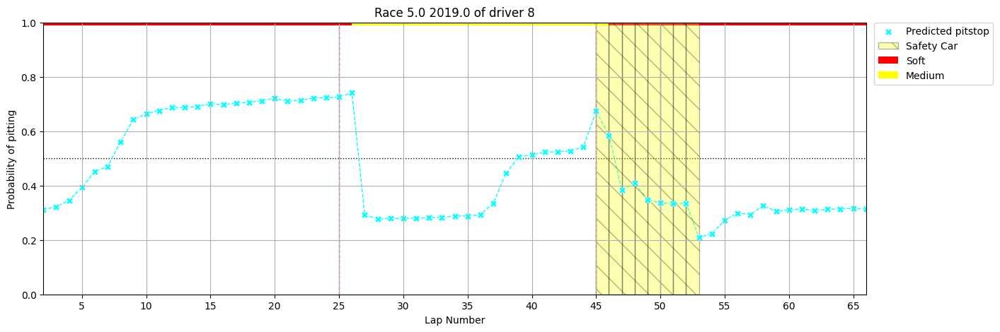

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber    LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                  

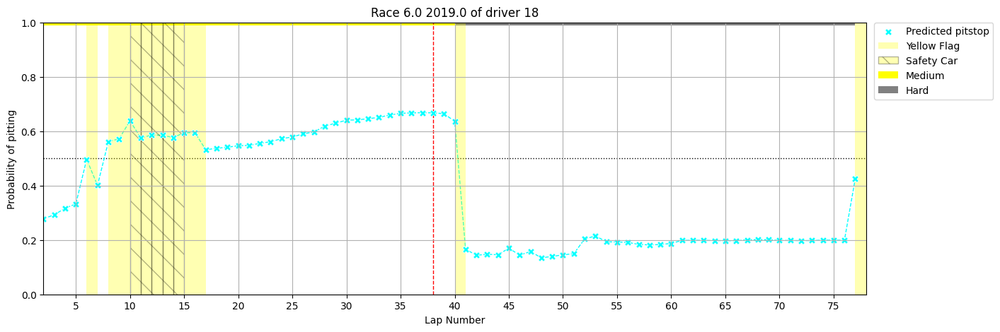

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber    LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                  

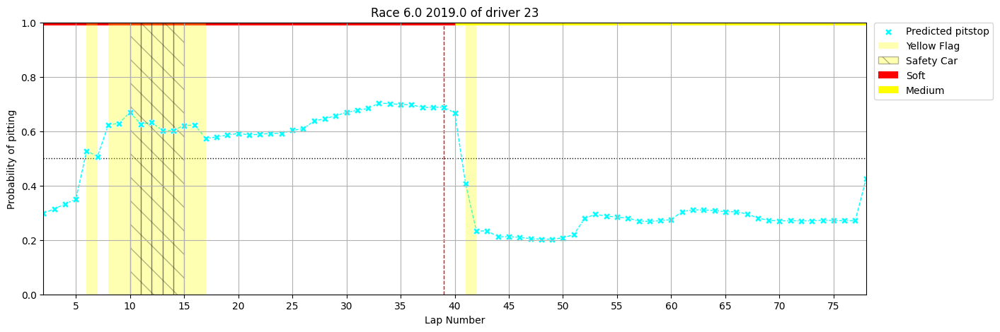

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber    LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                  

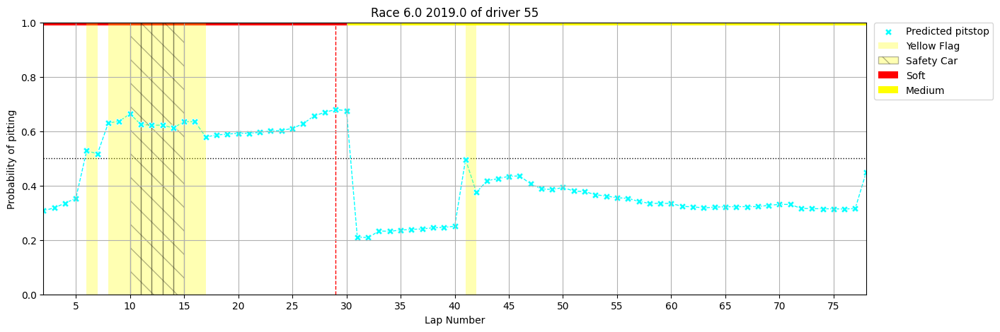

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


       LapNumber    LapTime  TyreLife  Stint  DistanceToDriverAhead  NumberOfPitStops  Position  GapToLeader  IntervalToPositionAhead  LapsToLeader  TotalLaps  Compound_HARD  Compound_MEDIUM  Compound_SOFT  Track_Austin  Track_Baku  Track_Barcelona  Track_Budapest  Track_Imola  Track_Jeddah  Track_Le_Castellet  Track_Lusail  Track_Melbourne  Track_Mexico_City  Track_Miami  Track_Monaco  Track_Monte_Carlo  Track_Montréal  Track_Monza  Track_Mugello  Track_Nürburgring  Track_Portimão  Track_Sakhir  Track_Shanghai  Track_Silverstone  Track_Singapore  Track_Sochi  Track_Spa-Francorchamps  Track_Spielberg  Track_Suzuka  Track_São_Paulo  Track_Yas_Island  Track_Zandvoort  Green  Yellow     SC    Red    VSC  SC_ending
index                                                                                                                                                                                                                                                                                  

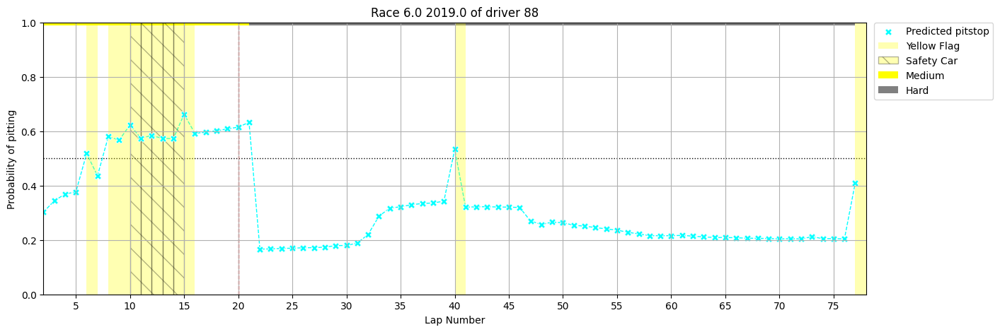

c:\Users\Nelson Jeanrenaud\miniconda3\envs\bsc\Lib\site-packages\sklearn\base.py:464: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


In [13]:
for i in range(0, 20):
    explain_race(i)